<a href="https://colab.research.google.com/github/EllieZhangy/Artwork-Classification-and-Style-Transfer/blob/main/Style_Transfer_Cycle_GANs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Artwork Classification and Style Transfer
## Task2: Style Transfer (Cycle GANS)

In [14]:
import warnings
warnings.filterwarnings("ignore")

In [15]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
import os
import math
import random

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2

In [18]:
def set_seed(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)

SEED = 42
set_seed(SEED)

###0.Setup and Some Explorations

In [19]:
BASE_PATH = '/content/drive/MyDrive/Deep Learning/Style_Transfer'
#BASE_PATH = '.'
for dirname, _, filenames in os.walk(BASE_PATH):
    print(dirname)

/content/drive/MyDrive/Deep Learning/Style_Transfer
/content/drive/MyDrive/Deep Learning/Style_Transfer/resized
/content/drive/MyDrive/Deep Learning/Style_Transfer/resized/resized
/content/drive/MyDrive/Deep Learning/Style_Transfer/gan-getting-started
/content/drive/MyDrive/Deep Learning/Style_Transfer/photo2
/content/drive/MyDrive/Deep Learning/Style_Transfer/monet
/content/drive/MyDrive/Deep Learning/Style_Transfer/photo3
/content/drive/MyDrive/Deep Learning/Style_Transfer/photo1
/content/drive/MyDrive/Deep Learning/Style_Transfer/photo


In [21]:
import os
import shutil
import random

SOURCE_PATH = os.path.join(BASE_PATH, "gan-getting-started")
TARGET_PATH = os.path.join(BASE_PATH, "monet_image1")

# Ensure the target directory exists
if not os.path.exists(TARGET_PATH):
    os.makedirs(TARGET_PATH)

# List all files in the source directory
all_files = [f for f in os.listdir(SOURCE_PATH) if os.path.isfile(os.path.join(SOURCE_PATH, f))]
selected_files = random.sample(all_files, 100)

for file_name in selected_files:
    source_file_path = os.path.join(SOURCE_PATH, file_name)
    target_file_path = os.path.join(TARGET_PATH, file_name)

    shutil.move(source_file_path, target_file_path)

print(f"Moved {len(selected_files)} images to {TARGET_PATH}")


Moved 100 images to /content/drive/MyDrive/Deep Learning/Style_Transfer/monet_image1


In [22]:
MONET_PATH_JPG = os.path.join(BASE_PATH, "monet_image1")
PHOTO_PATH_JPG = os.path.join(BASE_PATH, "photo")
BEST_ARTS_FOR_NST = os.path.join(BASE_PATH,"resized", "resized")

In [23]:
def print_folder_statistics(path):
    d_image_sizes = {}
    max_to_print = 20
    try:
        for image_name in os.listdir(path):
            image = cv2.imread(os.path.join(path, image_name))
            d_image_sizes[image.shape] = d_image_sizes.get(image.shape, 0) + 1
            if len(d_image_sizes) >= max_to_print:
                break
        for i, (size, count) in enumerate(d_image_sizes.items()):
            print(f"shape: {size}\tcount: {count}")
            if i >= max_to_print:
                break
    except:
        pass

print(f"Monet images:")
print_folder_statistics(MONET_PATH_JPG)
print("-" * 10)
print(f"Photo images:")
print_folder_statistics(PHOTO_PATH_JPG)
print("-" * 10)
print(f"Best Artworks:")
print_folder_statistics(BEST_ARTS_FOR_NST)
print("-" * 10)

Monet images:
shape: (256, 256, 3)	count: 100
----------
Photo images:
shape: (256, 256, 3)	count: 1672
----------
Best Artworks:
shape: (614, 422, 3)	count: 1
shape: (738, 556, 3)	count: 1
shape: (448, 377, 3)	count: 1
shape: (450, 473, 3)	count: 1
shape: (312, 229, 3)	count: 1
shape: (390, 483, 3)	count: 1
shape: (312, 471, 3)	count: 1
shape: (312, 402, 3)	count: 1
shape: (244, 600, 3)	count: 1
shape: (736, 614, 3)	count: 1
shape: (540, 595, 3)	count: 1
shape: (469, 480, 3)	count: 1
shape: (346, 448, 3)	count: 1
shape: (540, 540, 3)	count: 1
shape: (614, 455, 3)	count: 1
shape: (614, 386, 3)	count: 1
shape: (540, 405, 3)	count: 1
shape: (453, 614, 3)	count: 1
shape: (733, 600, 3)	count: 1
shape: (542, 768, 3)	count: 1
----------


In [24]:
# let's save required size
IMAGE_SIZE = 256

In [25]:
def batch_visualization(path, n_images, is_random=True, figsize=(16, 16)):
    plt.figure(figsize=figsize)
    w = int(n_images ** .5)
    h = math.ceil(n_images / w)
    all_names = os.listdir(path)
    image_names = all_names[:n_images]
    if is_random:
        image_names = random.sample(all_names, n_images)
    for ind, image_name in enumerate(image_names):
        img = cv2.imread(os.path.join(path, image_name))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.subplot(h, w, ind + 1)
        plt.imshow(img)
        plt.axis("off")
    plt.show()

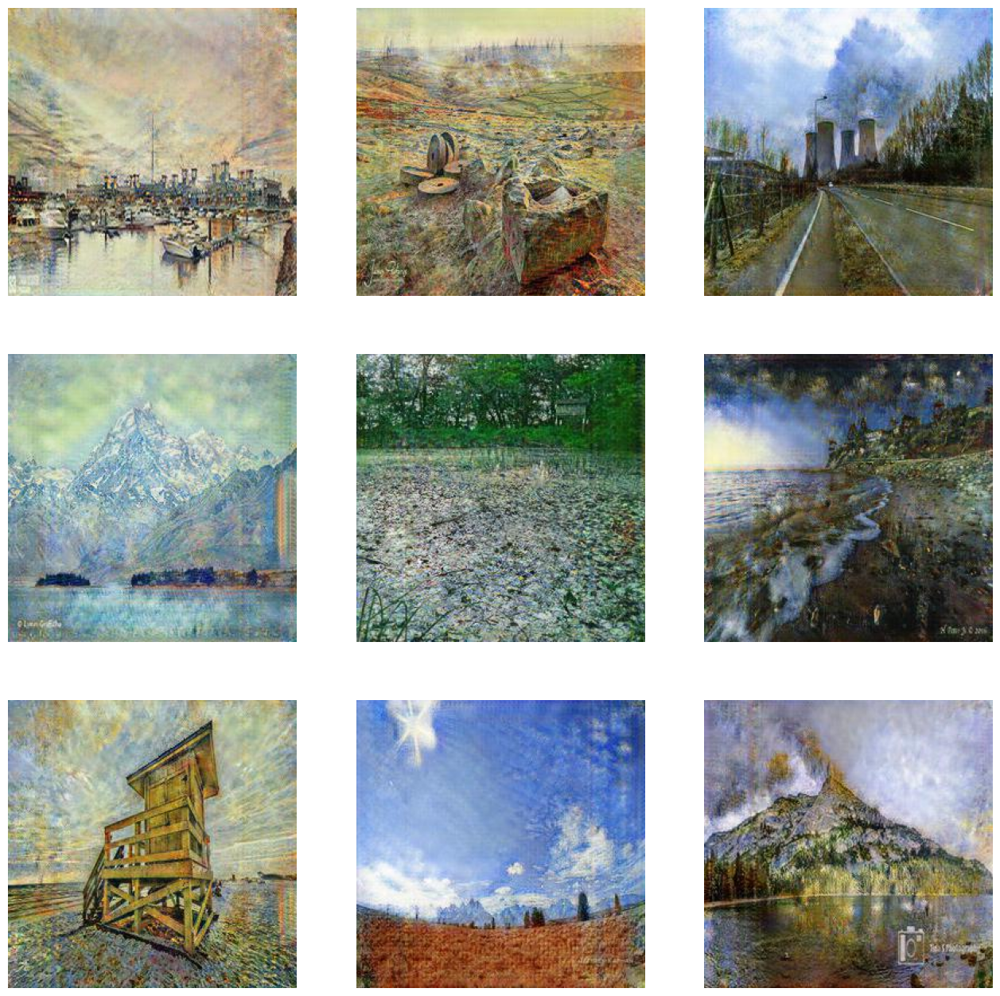

In [26]:
batch_visualization(MONET_PATH_JPG, 9, is_random=True)

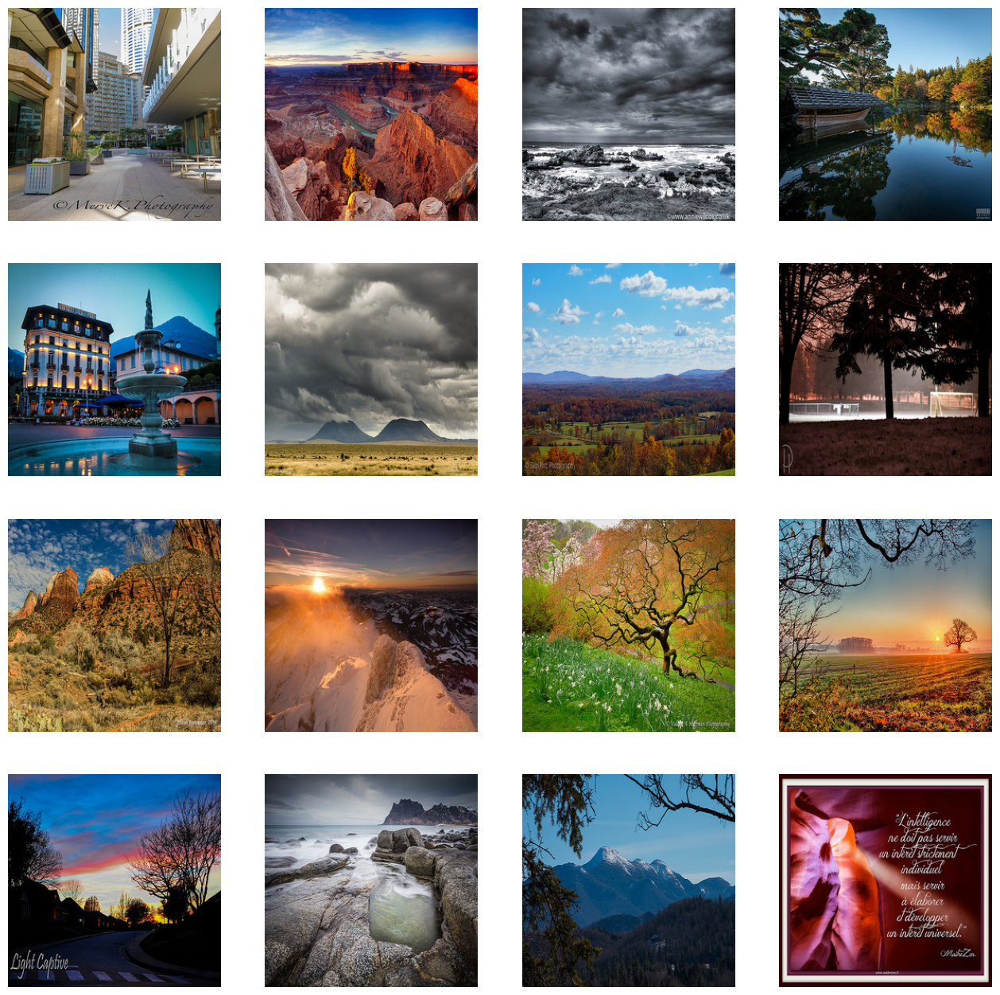

In [27]:
batch_visualization(PHOTO_PATH_JPG, 16, is_random=True)

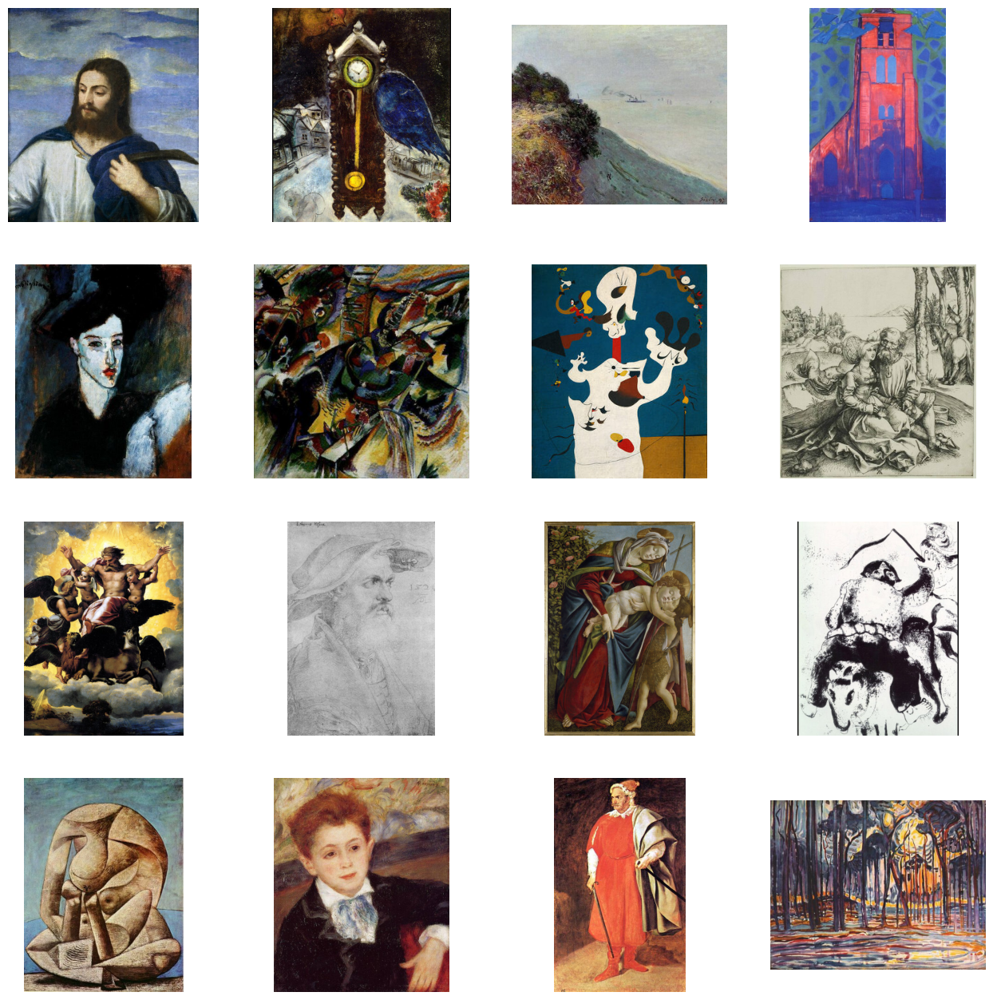

In [28]:
batch_visualization(BEST_ARTS_FOR_NST, 16, is_random=True)

### 1.Preparation (Function Defination)

In [29]:
!pip install tensorflow_addons

In [30]:
import tensorflow as tf
import keras

#### 1.1 Encoder

In [31]:
import tensorflow_addons as tfa

conv_initializer = tf.random_normal_initializer(mean=0.0, stddev=0.02)
gamma_initializer = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

def encode(input_layer, filters, size=3, strides=2, apply_instancenorm=True, activation=keras.layers.ReLU(), name='x'):
    block = keras.layers.Conv2D(filters, size, strides=strides, padding='same',
                     use_bias=False, kernel_initializer=conv_initializer,
                     name=f'encoder_{name}')(input_layer)
    if apply_instancenorm:
        block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)
    block = activation(block)
    return block

#### 1.2 Transform

In [32]:
def transform(input_layer, size=3, strides=1, name='x'):
    filters = input_layer.shape[-1]
    block = keras.layers.Conv2D(filters, size, strides=strides, padding='same', use_bias=False,
                     kernel_initializer=conv_initializer, name=f'transformer_{name}_1')(input_layer)
    block = keras.layers.ReLU()(block)
    block = keras.layers.Conv2D(filters, size, strides=strides, padding='same', use_bias=False,
                     kernel_initializer=conv_initializer, name=f'transformer_{name}_2')(block)
    block = keras.layers.Add()([block, input_layer])
    return block

#### 1.3 Decoder

In [33]:
def decode(input_layer, filters, size=3, strides=2, apply_instancenorm=True, name='x'):
    block = keras.layers.Conv2DTranspose(filters, size,  strides=strides, padding='same',
                              use_bias=False, kernel_initializer=conv_initializer,
                              name=f'decoder_{name}')(input_layer)
    if apply_instancenorm:
        block = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(block)
    block = keras.layers.ReLU()(block)
    return block

#### 1.4 Generator

In [34]:
def get_generator(height=IMAGE_SIZE, width=IMAGE_SIZE, channels=3, transformer_blocks=6):
    inputs = keras.layers.Input(shape=[height, width, channels], name='input_image')
    # Encoder
    enc_1 = encode(inputs, 64,  7, 1, apply_instancenorm=False, name='block_1') # (bs, 256, 256, 64)
    enc_2 = encode(enc_1, 128, 3, 2, apply_instancenorm=True, name='block_2')   # (bs, 128, 128, 128)
    enc_3 = encode(enc_2, 256, 3, 2, apply_instancenorm=True, name='block_3')   # (bs, 64, 64, 256)
    # Transformer
    x = enc_3
    for n in range(transformer_blocks):
        x = transform(x, 3, 1, name=f'block_{n+1}') # (bs, 64, 64, 256)
    # Decoder
    x_skip = keras.layers.Concatenate(name='enc_dec_skip_1')([x, enc_3]) # encoder - decoder skip connection
    dec_1 = decode(x_skip, 128, 3, 2, apply_instancenorm=True, name='block_1') # (bs, 128, 128, 128)
    x_skip = keras.layers.Concatenate(name='enc_dec_skip_2')([dec_1, enc_2]) # encoder - decoder skip connection
    dec_2 = decode(x_skip, 64,  3, 2, apply_instancenorm=True, name='block_2') # (bs, 256, 256, 64)
    x_skip = keras.layers.Concatenate(name='enc_dec_skip_3')([dec_2, enc_1]) # encoder - decoder skip connection
    outputs = last = keras.layers.Conv2D(channels, 7, strides=1, padding='same',
                              kernel_initializer=conv_initializer, use_bias=False,
                              activation='tanh', name='decoder_output_block')(x_skip) # (bs, 256, 256, 3)
    return keras.Model(inputs, outputs)

#### 1.4 Discriminator

In [35]:
def get_discriminator(height=IMAGE_SIZE, width=IMAGE_SIZE, channels=3):
    inputs = keras.layers.Input(shape=[height, width, channels], name='input_image')
    x = encode(inputs, 64,  4, 2, apply_instancenorm=False, activation=keras.layers.LeakyReLU(0.2), name='block_1') # (bs, 128, 128, 64)
    x = encode(x, 128, 4, 2, apply_instancenorm=True, activation=keras.layers.LeakyReLU(0.2), name='block_2')       # (bs, 64, 64, 128)
    x = encode(x, 256, 4, 2, apply_instancenorm=True, activation=keras.layers.LeakyReLU(0.2), name='block_3')       # (bs, 32, 32, 256)
    x = encode(x, 512, 4, 1, apply_instancenorm=True, activation=keras.layers.LeakyReLU(0.2), name='block_4')       # (bs, 32, 32, 512)
    outputs = keras.layers.Conv2D(1, 4, strides=1, padding='valid', kernel_initializer=conv_initializer)(x)                # (bs, 29, 29, 1)
    discriminator = keras.Model(inputs, outputs)
    return discriminator

In [36]:
adv_loss_fn = keras.losses.MeanSquaredError()
# Discriminator loss {0: fake, 1: real} (The discriminator loss outputs the average of the real and generated loss)
def discriminator_loss(real, generated):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    generated_loss = adv_loss_fn(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5

# Generator loss
def generator_loss(generated):
    return adv_loss_fn(tf.ones_like(generated), generated)


# Cycle consistency loss (measures if original photo and the twice transformed photo to be similar to one another)
def calc_cycle_loss(real_image, cycled_image, Lambda):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return Lambda * loss1

# Identity loss (compares the image with its generator (i.e. photo with photo generator))
def identity_loss(real_image, same_image, Lambda):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return Lambda * 0.5 * loss

### 2.Cycle GAN Model

In [37]:
class CycleGan(keras.Model):
    def __init__(self, monet_generator, photo_generator,
                 monet_discriminator, photo_discriminator, lambda_cycle=10):
        super(CycleGan, self).__init__()
        self.monet_generator = monet_generator
        self.photo_generator = photo_generator
        self.monet_discriminator = monet_discriminator
        self.photo_discriminator = photo_discriminator
        self.lambda_cycle = lambda_cycle

    def compile(self, monet_generator_optimizer, photo_generator_optimizer,
                monet_discriminator_optimizer, photo_discriminator_optimizer,
                gen_loss_fn, disc_loss_fn, cycle_loss_fn, identity_loss_fn):
        super(CycleGan, self).compile()
        self.monet_generator_optimizer = monet_generator_optimizer
        self.photo_generator_optimizer = photo_generator_optimizer
        self.monet_discriminator_optimizer = monet_discriminator_optimizer
        self.photo_discriminator_optimizer = photo_discriminator_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        with tf.GradientTape(persistent=True) as tape:
            # photo to monet back to photo
            fake_monet = self.monet_generator(real_photo, training=True)
            cycled_photo = self.photo_generator(fake_monet, training=True)
            # monet to photo back to monet
            fake_photo = self.photo_generator(real_monet, training=True)
            cycled_monet = self.monet_generator(fake_photo, training=True)
            # generating itself
            same_monet = self.monet_generator(real_monet, training=True)
            same_photo = self.photo_generator(real_photo, training=True)
            # discriminator used to check, inputing real images
            disc_real_monet = self.monet_discriminator(real_monet, training=True)
            disc_real_photo = self.photo_discriminator(real_photo, training=True)
            # discriminator used to check, inputing fake images
            disc_fake_monet = self.monet_discriminator(fake_monet, training=True)
            disc_fake_photo = self.photo_discriminator(fake_photo, training=True)
            # evaluate generator loss
            monet_gen_loss = self.gen_loss_fn(disc_fake_monet)
            photo_gen_loss = self.gen_loss_fn(disc_fake_photo)
            # evaluate total cycle consistency loss
            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle) + \
                self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle)
            # evaluate total generator loss
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss + self.identity_loss_fn(real_monet, same_monet, self.lambda_cycle)
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_cycle)
            # evaluate discriminator loss
            monet_disc_loss = self.disc_loss_fn(disc_real_monet, disc_fake_monet)
            photo_disc_loss = self.disc_loss_fn(disc_real_photo, disc_fake_photo)
        # Calculate the gradients for generator and discriminator
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                self.monet_generator.trainable_variables)
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.photo_generator.trainable_variables)
        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.monet_discriminator.trainable_variables)
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.photo_discriminator.trainable_variables)
        # Apply the gradients to the optimizer
        self.monet_generator_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.monet_generator.trainable_variables))
        self.photo_generator_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.photo_generator.trainable_variables))
        self.monet_discriminator_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.monet_discriminator.trainable_variables))
        self.photo_discriminator_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.photo_discriminator.trainable_variables))
        return {'monet_gen_loss': total_monet_gen_loss,
                'photo_gen_loss': total_photo_gen_loss,
                'monet_disc_loss': monet_disc_loss,
                'photo_disc_loss': photo_disc_loss
               }

### 3.Data and Pipeline

In [38]:
def visualize_ds(ds, deprocess=True):
    style, content = next(iter(ds))
    num_to_vis = 5
    fig, axes = plt.subplots(nrows=2, ncols=num_to_vis, figsize=(15, 5))
    [ax.axis("off") for ax in np.ravel(axes)]
    for (axis, style_image, content_image) in zip(axes.T, style[0:num_to_vis], content[0:num_to_vis]):
        (ax_style, ax_content) = axis
        if deprocess:
            ax_style.imshow(deprocess_image(style_image))
        else:
            ax_style.imshow(style_image.numpy().reshape((IMAGE_SIZE, IMAGE_SIZE, 3)) / 2. + 0.5)
        ax_style.set_title("Style Image")
        if deprocess:
            ax_content.imshow(deprocess_image(content_image))
        else:
            ax_content.imshow(content_image.numpy().reshape((IMAGE_SIZE, IMAGE_SIZE, 3)) / 2. + 0.5)
        ax_content.set_title("Content Image")

Found 100 files belonging to 1 classes.
Found 1672 files belonging to 1 classes.


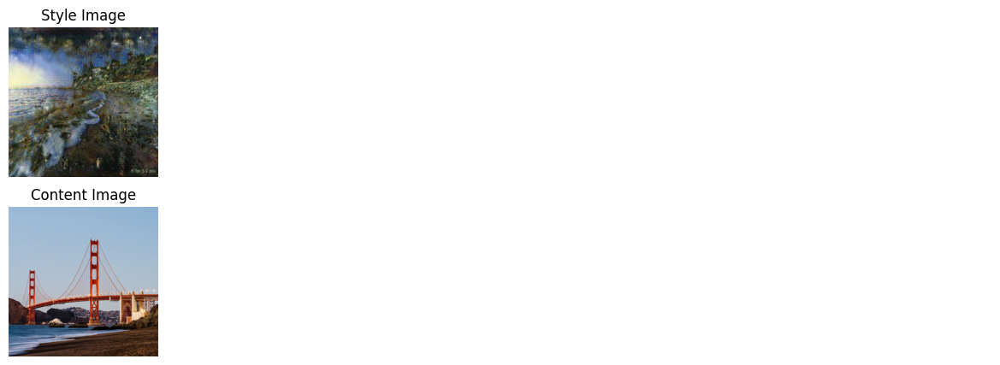

In [39]:
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    return (img / 127.5) - 1.0

BATCH_SIZE = 1
monet_ds = (keras.utils.image_dataset_from_directory(MONET_PATH_JPG, labels=None).unbatch()
            .map(normalize_img, num_parallel_calls=tf.data.AUTOTUNE).repeat())
photo_ds = (keras.utils.image_dataset_from_directory(PHOTO_PATH_JPG, labels=None).unbatch()
            .map(normalize_img, num_parallel_calls=tf.data.AUTOTUNE))
gan_ds = tf.data.Dataset.zip((monet_ds, photo_ds)).shuffle(BATCH_SIZE * 2).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

visualize_ds(gan_ds, deprocess=False)

### 4.Traning the Model

In [40]:
### Training Monitor Callback
def plot_cycle(example_sample, generator_a, generator_b, n_samples=1):
    fig, axes = plt.subplots(n_samples, 3, figsize=(22, (n_samples*6)))
    axes = axes.flatten()
    for n_sample in range(n_samples):
        idx = n_sample*3
        generated_a_sample = generator_a.predict(example_sample)
        generated_b_sample = generator_b.predict(generated_a_sample)
        axes[idx].set_title('Input image', fontsize=18)
        axes[idx].imshow(example_sample[0] * 0.5 + 0.5)
        axes[idx].axis('off')
        axes[idx+1].set_title('Generated image', fontsize=18)
        axes[idx+1].imshow(generated_a_sample[0] * 0.5 + 0.5)
        axes[idx+1].axis('off')
        axes[idx+2].set_title('Cycled image', fontsize=18)
        axes[idx+2].imshow(generated_b_sample[0] * 0.5 + 0.5)
        axes[idx+2].axis('off')
    plt.show()
    plt.close()


class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""
    def __init__(self, monet_path='monet', photo_path='photo'):
        self.test_monet, self.test_photo = next(iter(gan_ds))
        self.monet_path = monet_path
        self.photo_path = photo_path
        # Create directories to save the generate images
        if not os.path.exists(self.monet_path):
            os.makedirs(self.monet_path)
        if not os.path.exists(self.photo_path):
            os.makedirs(self.photo_path)

    def on_epoch_end(self, epoch, logs=None):
        # Monet generated images
        prediction = self.model.monet_generator(self.test_photo, training=False)[0].numpy()
        prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
        cv2.imwrite(f'{self.monet_path}/generated_{epoch+1}.jpg', prediction)
        # Photo generated images
        prediction = self.model.photo_generator(self.test_monet, training=False)[0].numpy()
        prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
        cv2.imwrite(f'{self.photo_path}/generated_{epoch+1}.jpg', prediction)
        # Plot the Style, Content and the NST image
        plot_cycle(self.test_photo, self.model.monet_generator, self.model.photo_generator)
        plot_cycle(self.test_monet, self.model.photo_generator, self.model.monet_generator)

Epoch 1/2
1/1 [==============================] - 0s 301ms/step


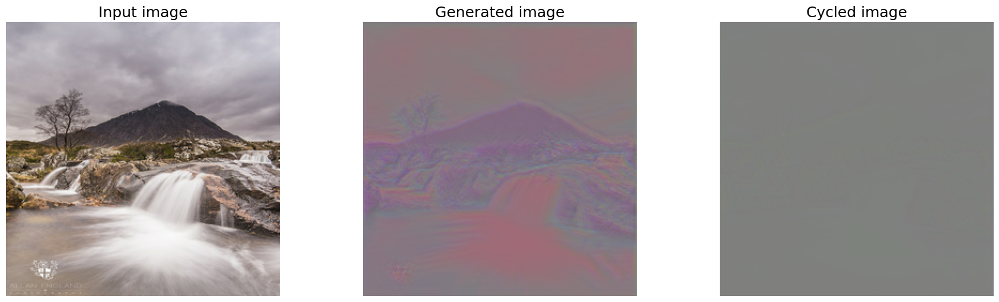

1/1 [==============================] - 0s 24ms/step


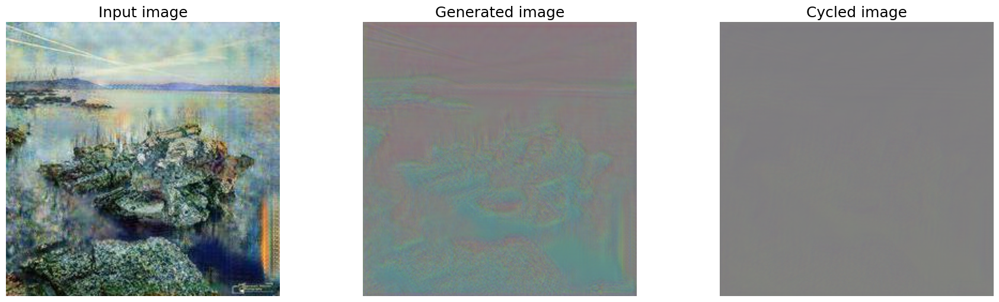

150/150 [==============================] - 93s 437ms/step - monet_gen_loss: 11.9423 - photo_gen_loss: 12.2899 - monet_disc_loss: 0.4988 - photo_disc_loss: 0.4984
Epoch 2/2
1/1 [==============================] - 0s 23ms/step


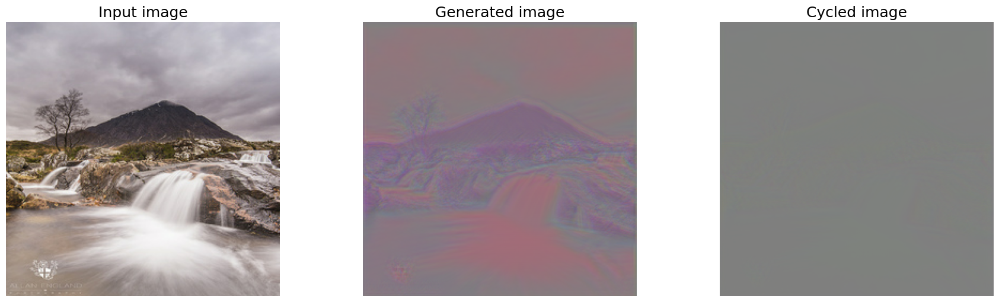

1/1 [==============================] - 0s 24ms/step


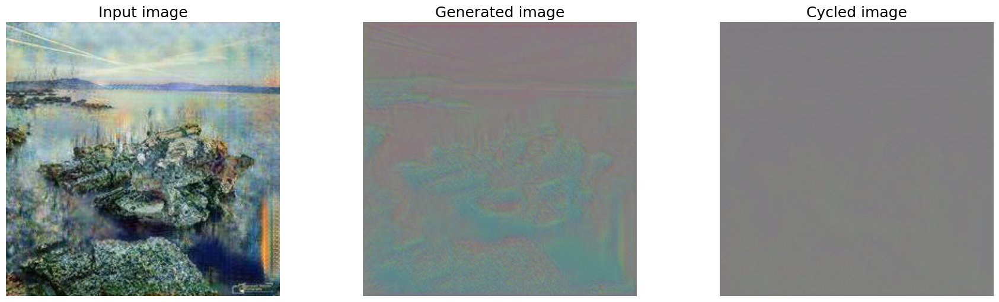

150/150 [==============================] - 67s 447ms/step - monet_gen_loss: 12.1297 - photo_gen_loss: 12.5150 - monet_disc_loss: 0.4977 - photo_disc_loss: 0.4971


In [41]:
TRANSFORMER_BLOCKS = 6
# Networks
monet_generator = get_generator(height=None, width=None, transformer_blocks=TRANSFORMER_BLOCKS) # transforms photos to Monet-esque paintings
photo_generator = get_generator(height=None, width=None, transformer_blocks=TRANSFORMER_BLOCKS) # transforms Monet paintings to be more like photos
monet_discriminator = get_discriminator(height=None, width=None) # differentiates real Monet paintings and generated Monet paintings
photo_discriminator = get_discriminator(height=None, width=None) # differentiates real photos and generated photos
# Optimizers
lr = 2e-7
monet_generator_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5)
photo_generator_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5)
monet_discriminator_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5)
photo_discriminator_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5)
# Create GAN
gan_model = CycleGan(monet_generator, photo_generator,
                     monet_discriminator, photo_discriminator)
gan_model.compile(monet_generator_optimizer, photo_generator_optimizer,
                  monet_discriminator_optimizer, photo_discriminator_optimizer,
                  generator_loss, discriminator_loss, calc_cycle_loss, identity_loss)
gan_monitor_cb = GANMonitor()
EPOCHS = 2
history = gan_model.fit(gan_ds, epochs=EPOCHS, callbacks=[gan_monitor_cb], steps_per_epoch=(100//2//BATCH_SIZE))

#### (Save and Load the Model)

In [ ]:
model_dir = '/content/drive/MyDrive/DL_Final/Models/'
monet_generator.save(model_dir+'monet_generator.h5')
photo_generator.save(model_dir+'photo_generator.h5')
monet_discriminator.save(model_dir+'monet_discriminator.h5')
photo_discriminator.save(model_dir+'photo_discriminator.h5')


In [ ]:
monet_generator = keras.models.load_model("/content/drive/MyDrive/DL_Final/Models/monet_generator.h5") # transforms photos to Monet-esque paintings
photo_generator = keras.models.load_model("/content/drive/MyDrive/DL_Final/Models/photo_generator.h5") # transforms Monet paintings to be more like photos
monet_discriminator = keras.models.load_model("/content/drive/MyDrive/DL_Final/Models/monet_discriminator.h5") # differentiates real Monet paintings and generated Monet paintings
photo_discriminator = keras.models.load_model("/content/drive/MyDrive/DL_Final/Models/photo_discriminator.h5") # differentiates real photos and generated photos
# Create GAN
gan_model = CycleGan(monet_generator, photo_generator,
                     monet_discriminator, photo_discriminator)
gan_model.compile(monet_generator_optimizer, photo_generator_optimizer,
                  monet_discriminator_optimizer, photo_discriminator_optimizer,
                  generator_loss, discriminator_loss, calc_cycle_loss, identity_loss)
#EPOCHS = 1
#history = gan_model.fit(gan_ds, epochs=EPOCHS, callbacks=[gan_monitor_cb], steps_per_epoch=(300//BATCH_SIZE))

#### 5. Model Evaluation and Result Analysis

In [48]:
from tensorflow.keras.callbacks import TensorBoard

log_dir5 = "/content/drive/MyDrive/DL_Final/logs/model5"
tensorboard_callback = TensorBoard(log_dir=log_dir5, histogram_freq=1)

In [49]:
tensorboard = TensorBoard(log_dir5)
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Epoch 1/8
1/1 [==============================] - 0s 23ms/step


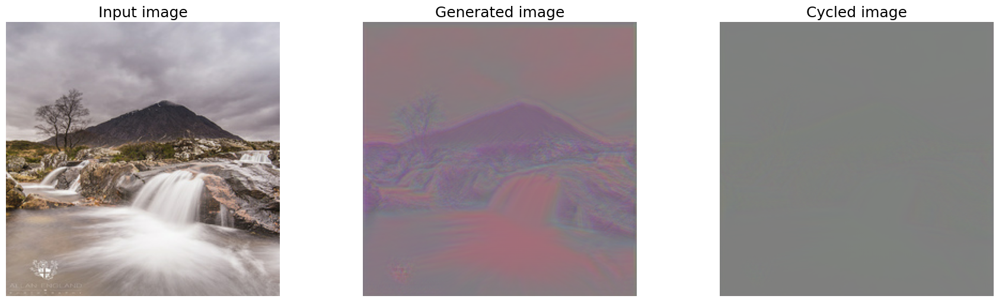

1/1 [==============================] - 0s 24ms/step


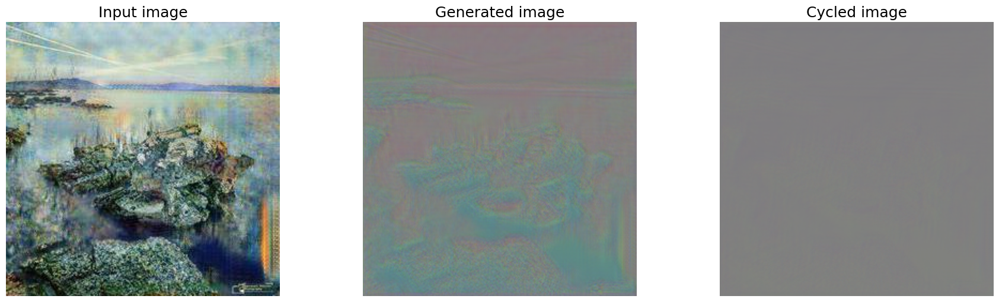

100/100 [==============================] - 46s 456ms/step - monet_gen_loss: 12.0416 - photo_gen_loss: 12.4322 - monet_disc_loss: 0.4964 - photo_disc_loss: 0.4956
Epoch 2/8
1/1 [==============================] - 0s 25ms/step


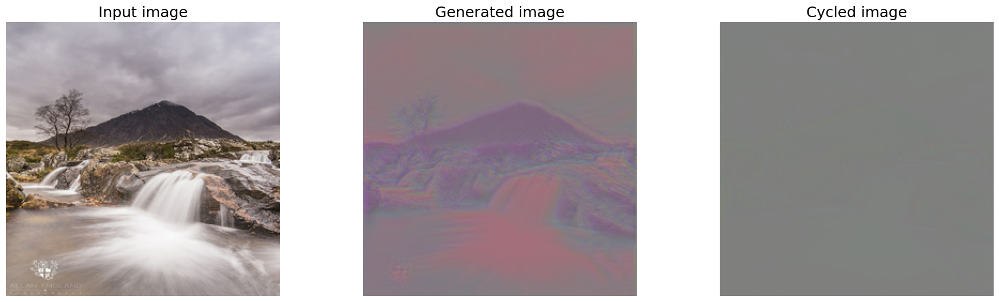

1/1 [==============================] - 0s 23ms/step


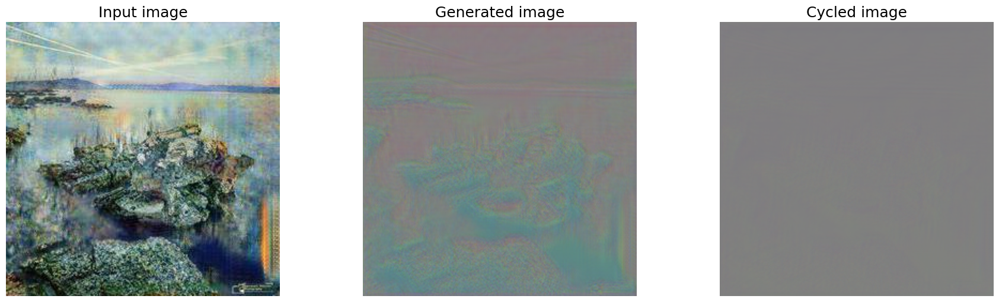

100/100 [==============================] - 45s 450ms/step - monet_gen_loss: 11.8191 - photo_gen_loss: 12.1246 - monet_disc_loss: 0.4955 - photo_disc_loss: 0.4945
Epoch 3/8
1/1 [==============================] - 0s 24ms/step


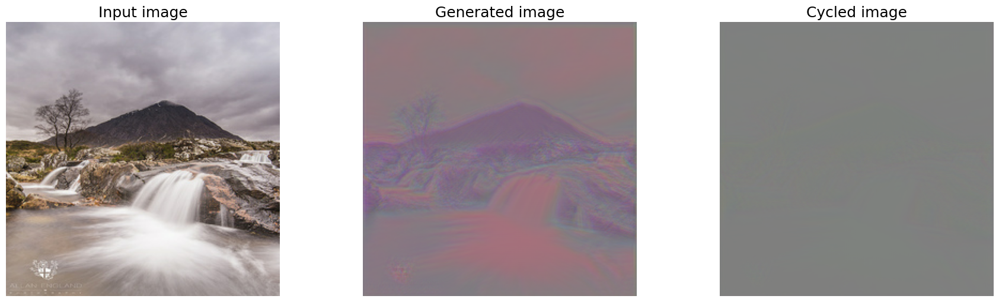

1/1 [==============================] - 0s 26ms/step


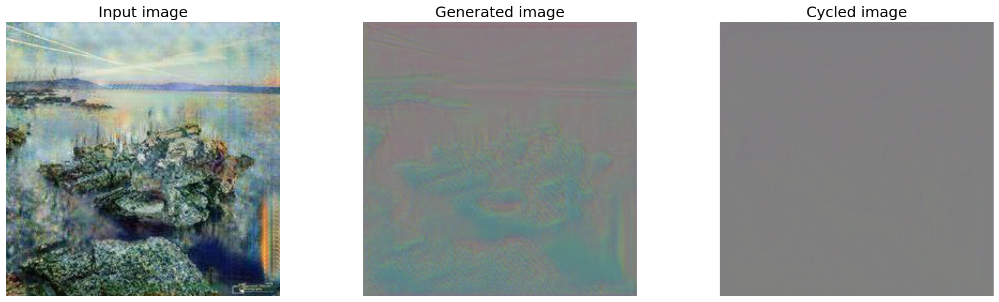

100/100 [==============================] - 45s 451ms/step - monet_gen_loss: 11.9658 - photo_gen_loss: 12.3396 - monet_disc_loss: 0.4947 - photo_disc_loss: 0.4936
Epoch 4/8
1/1 [==============================] - 0s 25ms/step


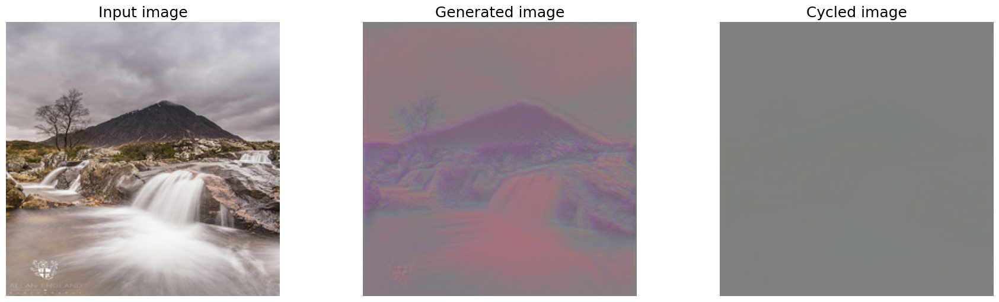

1/1 [==============================] - 0s 31ms/step


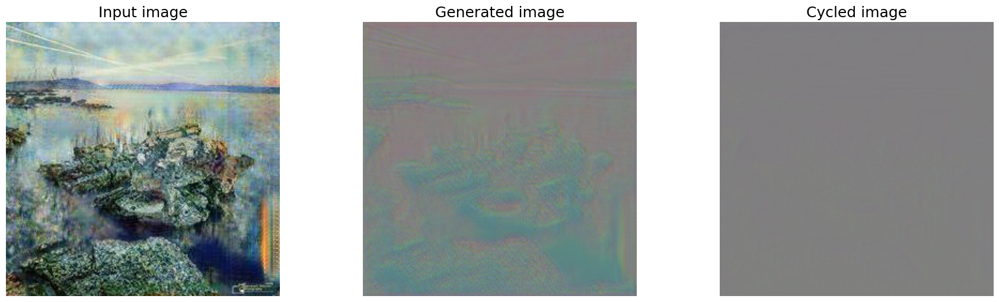

100/100 [==============================] - 45s 451ms/step - monet_gen_loss: 11.7075 - photo_gen_loss: 11.9982 - monet_disc_loss: 0.4938 - photo_disc_loss: 0.4923
Epoch 5/8
1/1 [==============================] - 0s 25ms/step


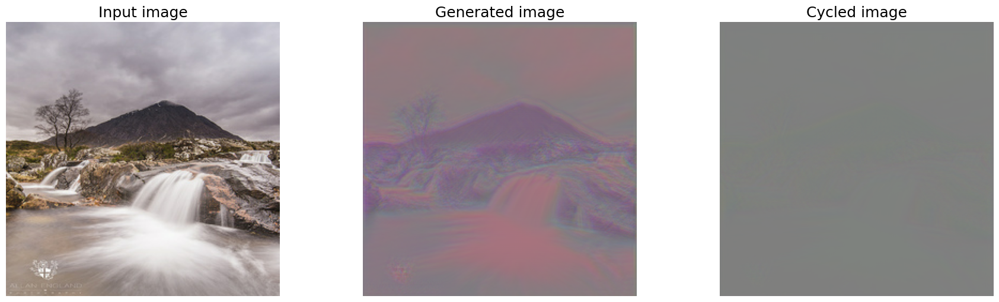

1/1 [==============================] - 0s 24ms/step


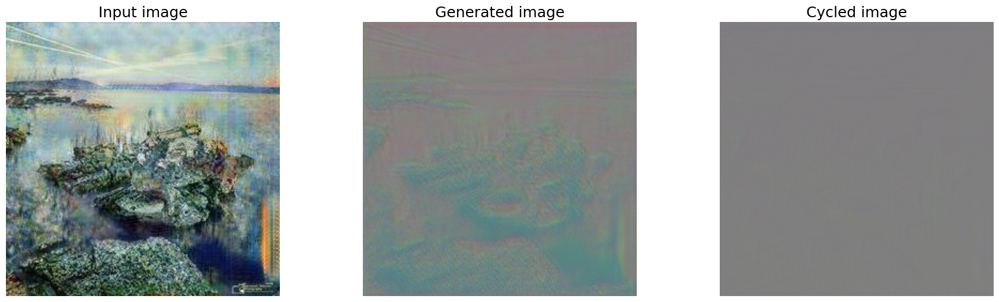

100/100 [==============================] - 45s 451ms/step - monet_gen_loss: 11.9109 - photo_gen_loss: 12.2674 - monet_disc_loss: 0.4929 - photo_disc_loss: 0.4912
Epoch 6/8
1/1 [==============================] - 0s 24ms/step


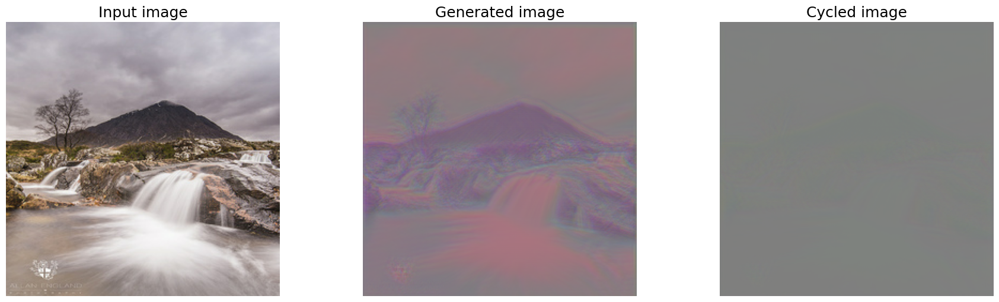

1/1 [==============================] - 0s 31ms/step


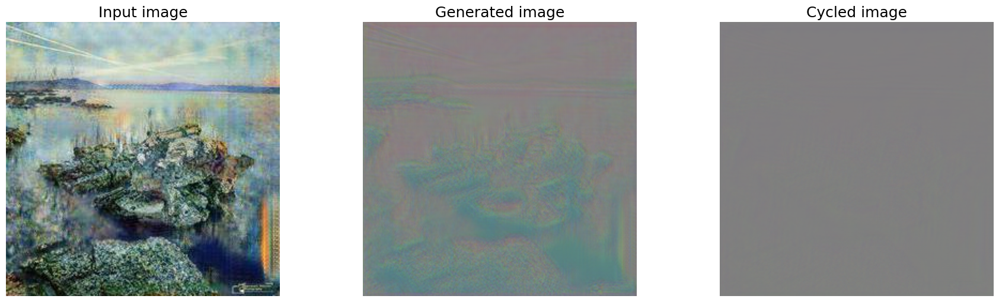

100/100 [==============================] - 45s 452ms/step - monet_gen_loss: 11.8573 - photo_gen_loss: 12.2095 - monet_disc_loss: 0.4919 - photo_disc_loss: 0.4899
Epoch 7/8
1/1 [==============================] - 0s 24ms/step


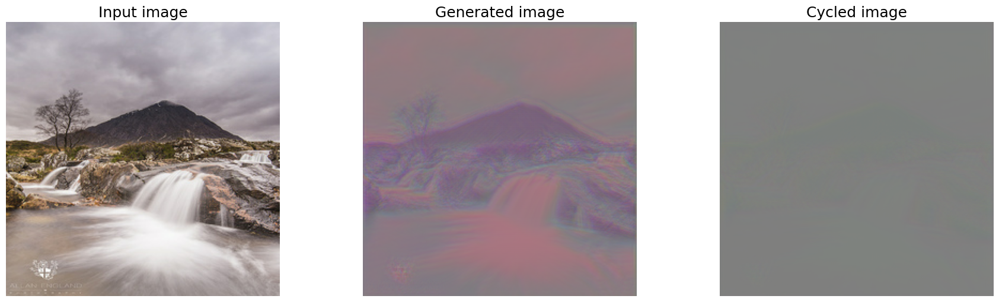

1/1 [==============================] - 0s 26ms/step


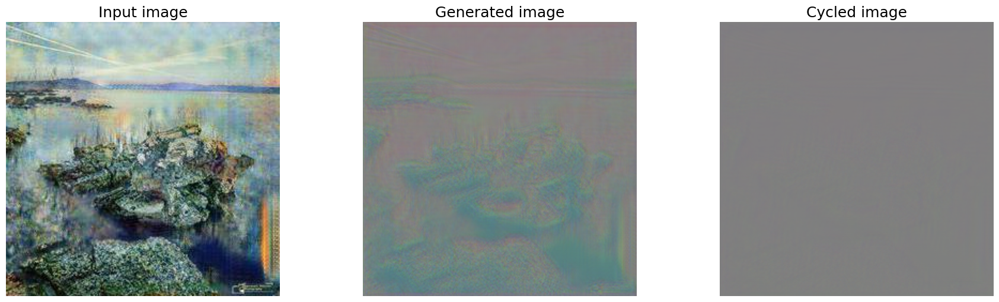

100/100 [==============================] - 45s 450ms/step - monet_gen_loss: 11.8929 - photo_gen_loss: 12.2723 - monet_disc_loss: 0.4909 - photo_disc_loss: 0.4888
Epoch 8/8
1/1 [==============================] - 0s 26ms/step


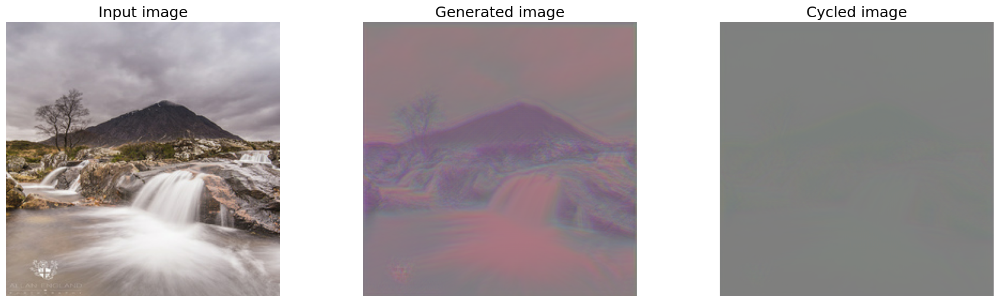

1/1 [==============================] - 0s 24ms/step


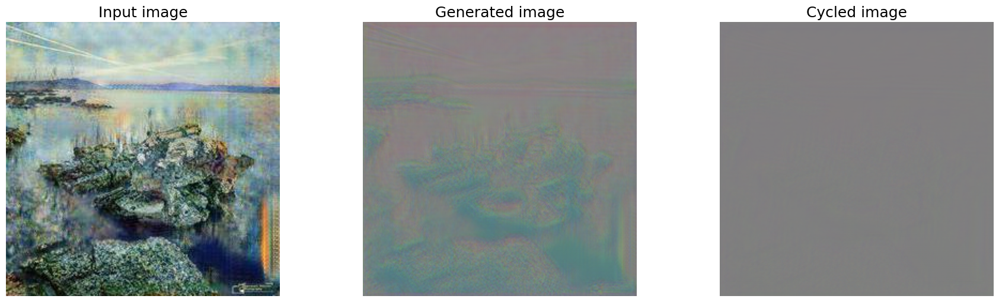

100/100 [==============================] - 45s 451ms/step - monet_gen_loss: 11.6424 - photo_gen_loss: 11.9265 - monet_disc_loss: 0.4899 - photo_disc_loss: 0.4875


In [51]:
history = gan_model.fit(gan_ds, epochs=8, callbacks=[gan_monitor_cb, tensorboard], steps_per_epoch=(100//BATCH_SIZE))

In [52]:
%tensorboard --logdir /content/drive/MyDrive/DL_Final/logs/model5 --port 6012

<IPython.core.display.Javascript object>

1/1 [==============================] - 0s 25ms/step


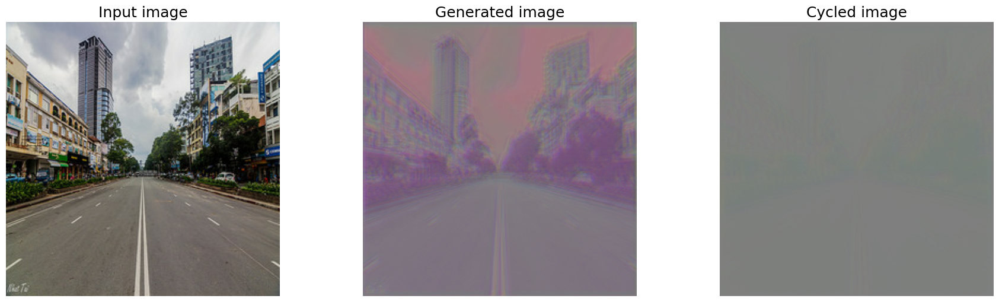

1/1 [==============================] - 0s 28ms/step


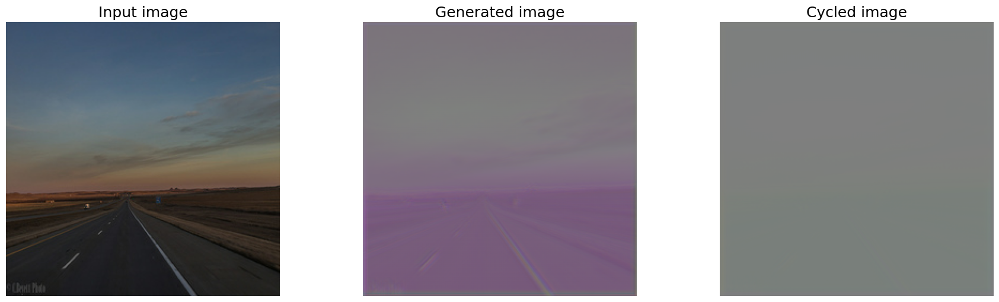

1/1 [==============================] - 0s 25ms/step


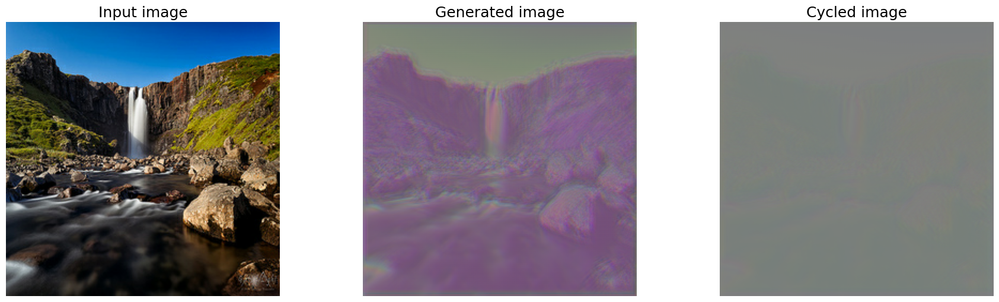

In [53]:
for _ in range(3):
    plot_cycle(next(iter(photo_ds.batch(1))), monet_generator, photo_generator, n_samples=1)


1/1 [==============================] - 0s 25ms/step


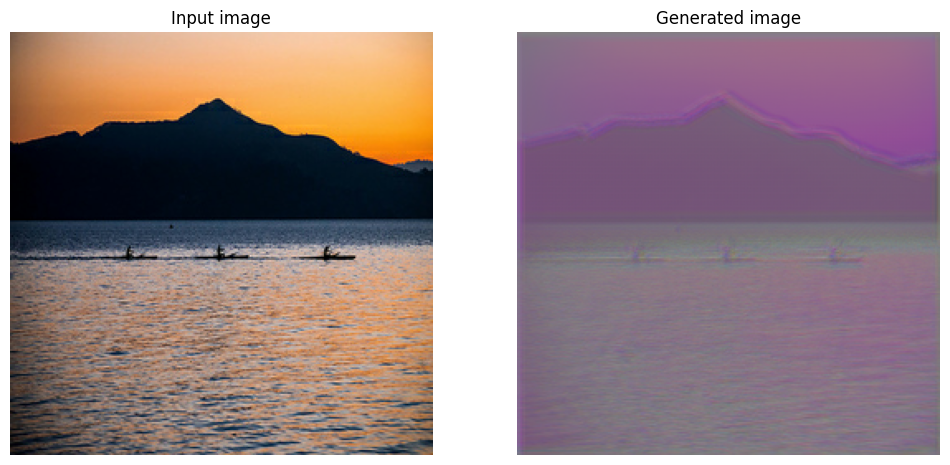

1/1 [==============================] - 0s 27ms/step


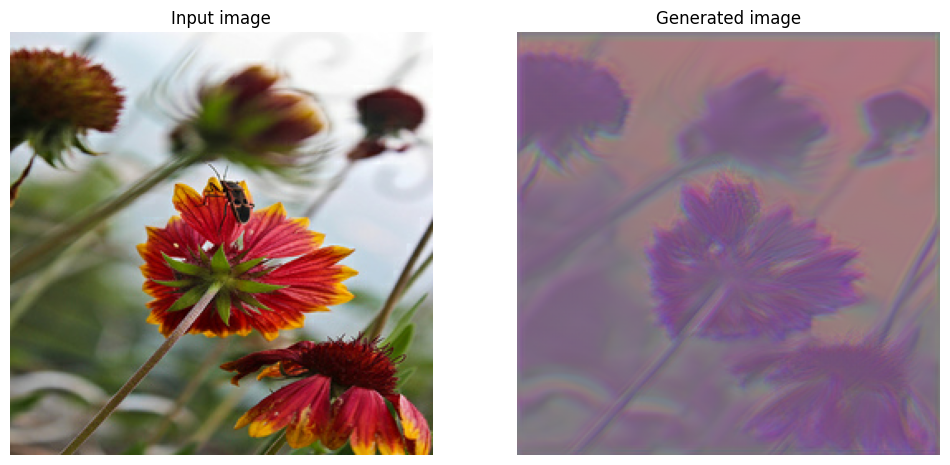

1/1 [==============================] - 0s 25ms/step


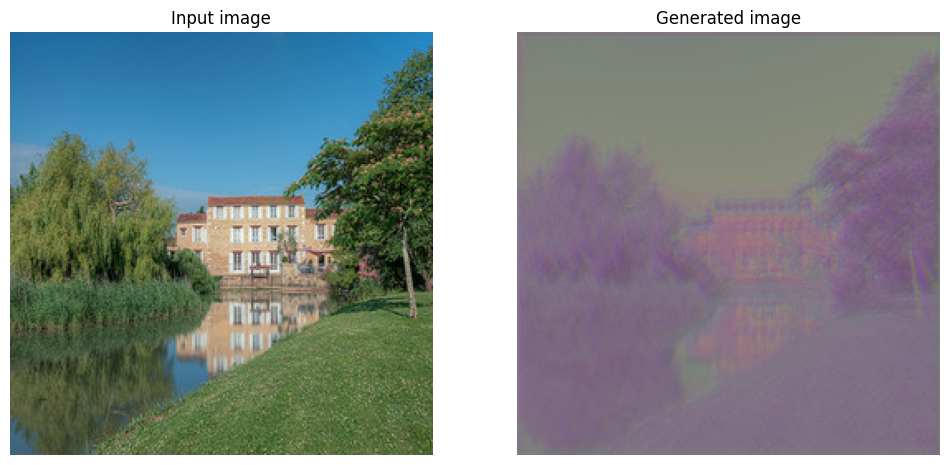

1/1 [==============================] - 0s 25ms/step


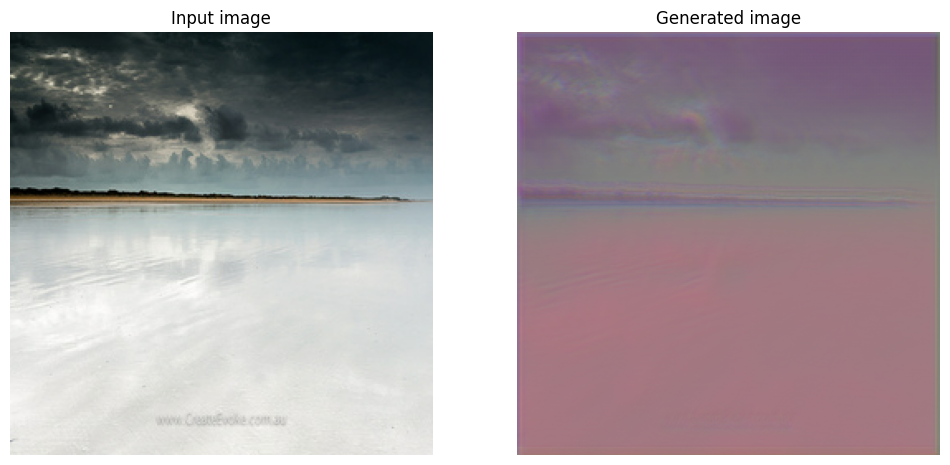

1/1 [==============================] - 0s 25ms/step


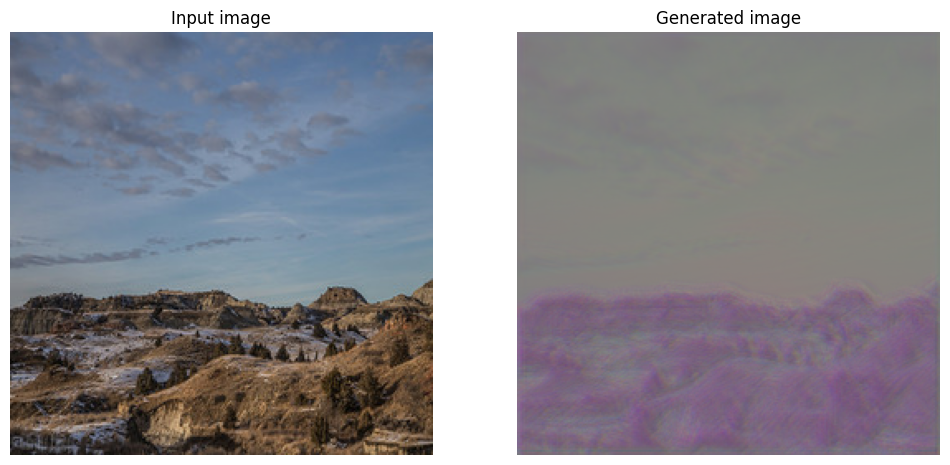

1/1 [==============================] - 0s 25ms/step


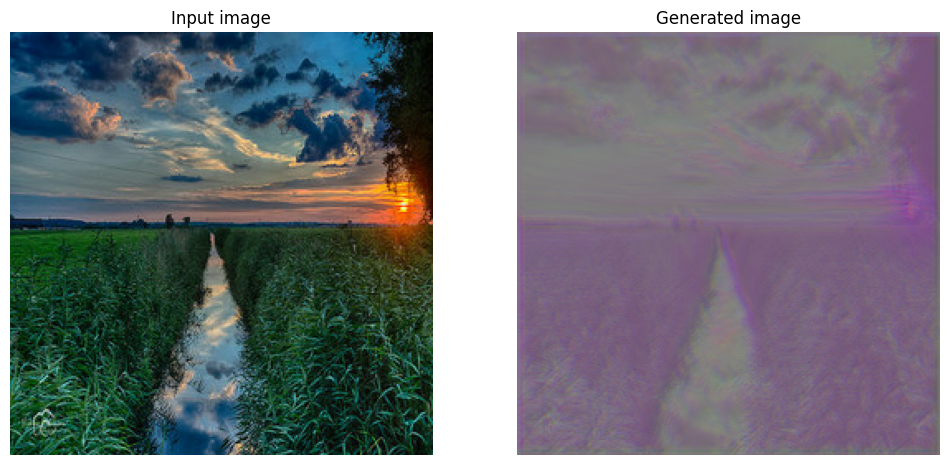

1/1 [==============================] - 0s 25ms/step


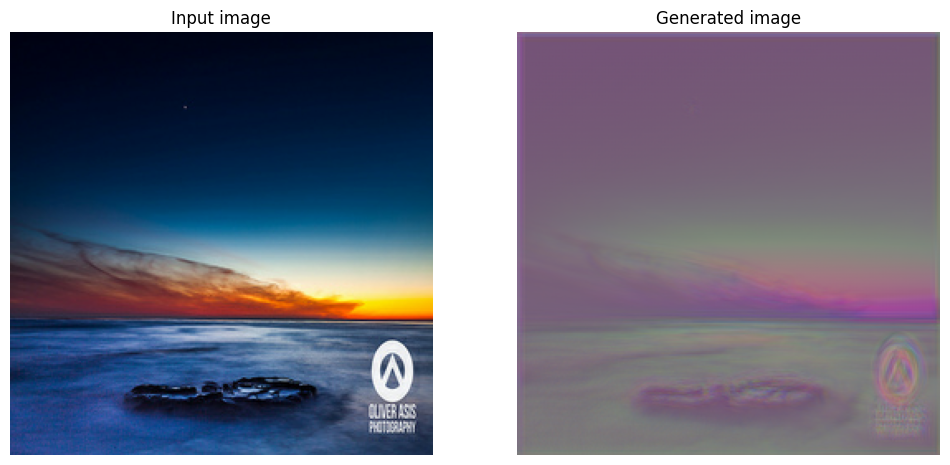

1/1 [==============================] - 0s 26ms/step


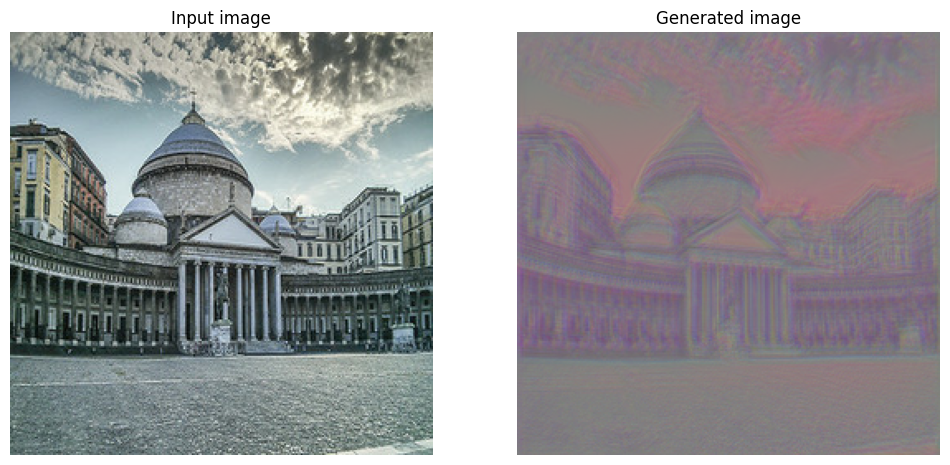

In [54]:
def display_generated_samples(ds, model, n_samples):
    ds_iter = iter(ds)
    for n_sample in range(n_samples):
        example_sample = next(ds_iter)
        generated_sample = model.predict(example_sample)
        f = plt.figure(figsize=(12, 12))
        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()

display_generated_samples(photo_ds.batch(1).take(8), monet_generator, 8)